# Creating an image mask

Calibration cannot compensate for every defect in a CCD. Some examples (a
non-exhaustive list):

+ Some hot pixels are not actually linear with exposure time.
+ Some pixels in the CCD may respond less to light than others in a way that
flat frames cannot compensate for.
+ There may be defects in all or part of a row or column of the chip.
+ Cosmic rays strike the CCD during every exposure. While those are eliminated
in the combined calibrated frames with the proper choice of combination
parameters, they are not removed from science images.

The first three are discussed in this notebook. Removal of cosmic rays from
science images is discussed [in the cosmic ray notebook]()

In [1]:
from pathlib import Path

import numpy as np
import matplotlib.pyplot as plt

from astropy import units as u
from astropy.nddata import CCDData

import ccdproc as ccdp
from photutils import detect_sources
from astrowidgets import ImageWidget

from convenience_functions import show_image, image_snippet

In [2]:
# Use custom style for larger fonts and figures
plt.style.use('guide.mplstyle')

## Detecting bad pixels with `ccdmask`

The ccdproc function [ccdmask](https://ccdproc.readthedocs.io/en/latest/api/ccdproc.ccdmask.html#ccdproc.ccdmask) uses an method that is
based on the [IRAF task ccdmask](http://stsdas.stsci.edu/cgi-bin/gethelp.cgi?ccdmask). The method works best when the
input image used to detect flaws in the CCD is the ratio of two flat frames with
different counts. That may or may not be available depending on what images are
collected.

In the example below, which uses images from Example 2 in the reduction
notebooks, the two extreme exposure times are 1 sec and 1.2 sec, but the average
counts in the images differ by 10,000. These were twilight flats taken just
after sunset.

Even with dome flats where the illumination is supposed to be constant the
counts may actually vary. If they do not, use a single flat for identifying bad
pixels instead of a ratio.

We begin by creating an image collection and then the information for all of the
calibrated, uncombined, flat images.

In [3]:
ex2_path = Path('example2-reduced')

ifc = ccdp.ImageFileCollection(ex2_path)

for long_values in ['history', 'comment']:
    try:
        ifc.summary.remove_column(long_values)
    except KeyError:
        # These two columns were not present, so removing them failed.
        # Just keep going.
        pass

In [4]:
flats = (ifc.summary['imagetyp'] == 'FLAT') & (ifc.summary['combined'] != True)
ifc.summary[flats]

file,simple,bitpix,naxis,naxis1,naxis2,date-obs,exptime,exposure,set-temp,ccd-temp,xpixsz,ypixsz,xbinning,ybinning,xorgsubf,yorgsubf,readoutm,filter,imagetyp,focallen,aptdia,aptarea,swcreate,swserial,sitelat,sitelong,telescop,instrume,notes,flipstat,swowner,date,time-obs,ut,timesys,radecsys,purged,latitude,longitud,altitude,lst,jd-obs,mjd-obs,biassec,trimsec,bunit,trim_image,trimim,subtract_dark,subdark,cstretch,cblack,cwhite,pedestal,bscale,bzero,subtract_bias,subbias,combined,hjd-obs,bjd-obs,azimuth,ha,readmode,st,lat-obs,long-obs,alt-obs,observat,ra,objctra,dec,objctdec,fwhm,zmag,_quinox,epoch,pa,_type1,_rval1,_rpix1,_delt1,_rota1,_type2,_rval2,_rpix2,_delt2,_rota2,_d1_1,_d1_2,_d2_1,_d2_2,tr1_0,tr1_1,tr1_2,tr1_3,tr1_4,tr1_5,tr1_6,tr1_7,tr1_8,tr1_9,tr1_10,tr1_11,tr1_12,tr1_13,tr1_14,tr2_0,tr2_1,tr2_2,tr2_3,tr2_4,tr2_5,tr2_6,tr2_7,tr2_8,tr2_9,tr2_10,tr2_11,tr2_12,tr2_13,tr2_14,pltsolvd,airmass,secz,alt-obj,az-obj,object,cd1_1,cd1_2,cd2_1,cd2_2,a_0_0,a_0_1,a_1_0,b_0_0,b_0_1,b_1_0,_ate,flat_correct,flatcor,wcsaxes,crpix1,crpix2,pc1_1,pc1_2,pc2_1,pc2_2,cdelt1,cdelt2,cunit1,cunit2,ctype1,ctype2,crval1,crval2,lonpole,latpole,radesys,equinox,a_order,a_0_2,a_1_1,a_2_0,b_order,b_0_2,b_1_1,b_2_0,ap_order,ap_0_0,ap_0_1,ap_0_2,ap_1_0,ap_1_1,ap_2_0,bp_order,bp_0_0,bp_0_1,bp_0_2,bp_1_0,bp_1_1,bp_2_0
str35,bool,int64,int64,int64,int64,object,object,object,object,object,object,object,object,object,object,object,object,object,str9,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object,object
AutoFlat-PANoRot-r-Bin1-001.fit,True,-64,2,4096,4096,2018-08-23T01:25:17,1.0,1.0,-20.0,-20.0225025,9.0,9.0,1,1,0,0,Monochrome,r,FLAT,3200.0,400.0,125663.70964050293,MaxIm DL Version 6.18 190601 00KPP,00KPP-F3HN8-9JMTJ-1CE5W-A4AX5-F3,+46:52:00.408,-96:27:11.8008,,AspenCG16,,,Matt Craig,23/08/18,01:25:17,01:25:17,UTC,FK5,True,+46:52:00.408,-96:27:11.8008,311.7999999995668,17:04:39.2507,2458353.559224537,58353.05922453704,[4096:4109],"[1:4096, :]",adu,trimim,ccd=<CCDData>,subdark,"ccd=<CCDData>, master=<CCDData>, exposure_time=exptime, exposure_unit=s, scale=True",--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--
AutoFlat-PANoRot-r-Bin1-002.fit,True,-64,2,4096,4096,2018-08-23T01:25:43,1.0,1.0,-20.0,-20.041362000000003,9.0,9.0,1,1,0,0,Monochrome,r,FLAT,3200.0,400.0,125663.70964050293,MaxIm DL Version 6.18 190601 00KPP,00KPP-F3HN8-9JMTJ-1CE5W-A4AX5-F3,+46:52:00.408,-96:27:11.8008,,AspenCG16,,,Matt Craig,23/08/18,01:25:43,01:25:43,UTC,FK5,True,+46:52:00.408,-96:27:11.8008,311.7999999995668,17:05:05.3219,2458353.559525463,58353.05952546297,[4096:4109],"[1:4096, :]

The best we can do here is the ratio of the first and last of the flat images
listed above.

In [5]:
first = ifc.summary['file'][flats][0]
last = ifc.summary['file'][flats][-1]

In [6]:
ccd1 = CCDData.read(ex2_path / first)
ccd2 = CCDData.read(ex2_path / last)

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa.


In [7]:
ratio = ccd2.divide(ccd1)

The ratio is roughly 0.85:

In [8]:
ratio.data.mean()

0.8424684815539478

Running `ccdmask` takes a little time but only needs to be done once, not once
for each image.

In [9]:
%%time
maskr = ccdp.ccdmask(ratio)

CPU times: user 1min 27s, sys: 295 ms, total: 1min 27s
Wall time: 1min 27s


The result of `ccdmask` is one where there is a defect and zero where the chip
is good, which matches the format of the mask numpy expects.

The input image and derived mask are shown below

Text(0.5, 1.0, 'Derived mask')

/Users/mcraig/conda-main/envs/ccd-guide/lib/python3.6/site-packages/astropy/visualization/mpl_normalize.py:113: RuntimeWarning: invalid value encountered in true_divide
  np.true_divide(values, self.vmax - self.vmin, out=values)
/Users/mcraig/conda-main/envs/ccd-guide/lib/python3.6/site-packages/matplotlib/colors.py:479: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


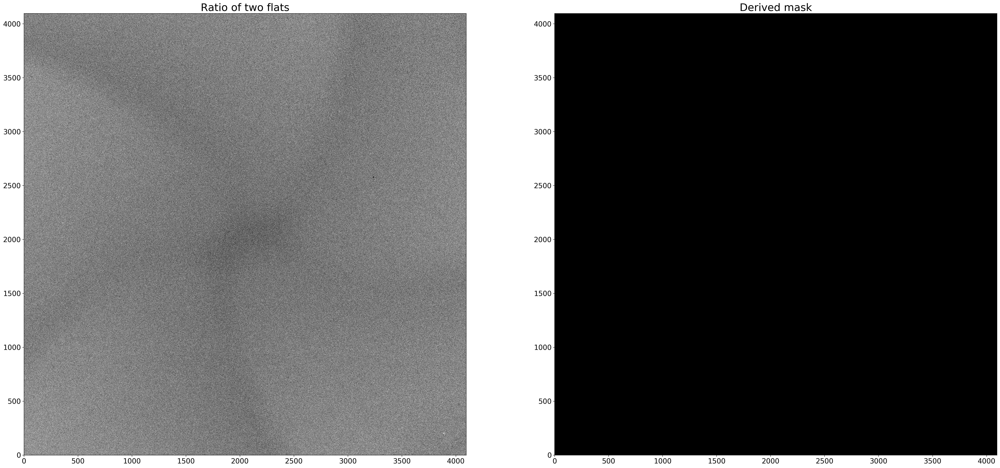

In [10]:
fig, axes = plt.subplots(1, 2, figsize=(40, 20))

show_image(ratio, cmap='gray', fig=fig, ax=axes[0], show_colorbar=False)
axes[0].set_title('Ratio of two flats')

show_image(maskr, cmap='gray', fig=fig, ax=axes[1], show_colorbar=False)
axes[1].set_title('Derived mask')

Two comments are in order:

+ The "starfish" pattern in the first image is an artifact of the camera
shutter. Ideally, a longer exposure time would be used for the flats to avoid
this.
+ It appear at first glance that there were no pixels masked. The problem is
that the masked regions are very small and, at the scale shown, happen to not be
visible.

Two defects in this CCD are shown below. The first is a small patch of pixels
that are vastly less sensitive than the rest. The second is a column on the left
edge of the CCD. It turns out this column is not actually exposed to light.
`ccdmask` correctly identifies both patches as bad.

Text(0.5, 1.0, 'Mask, same center')

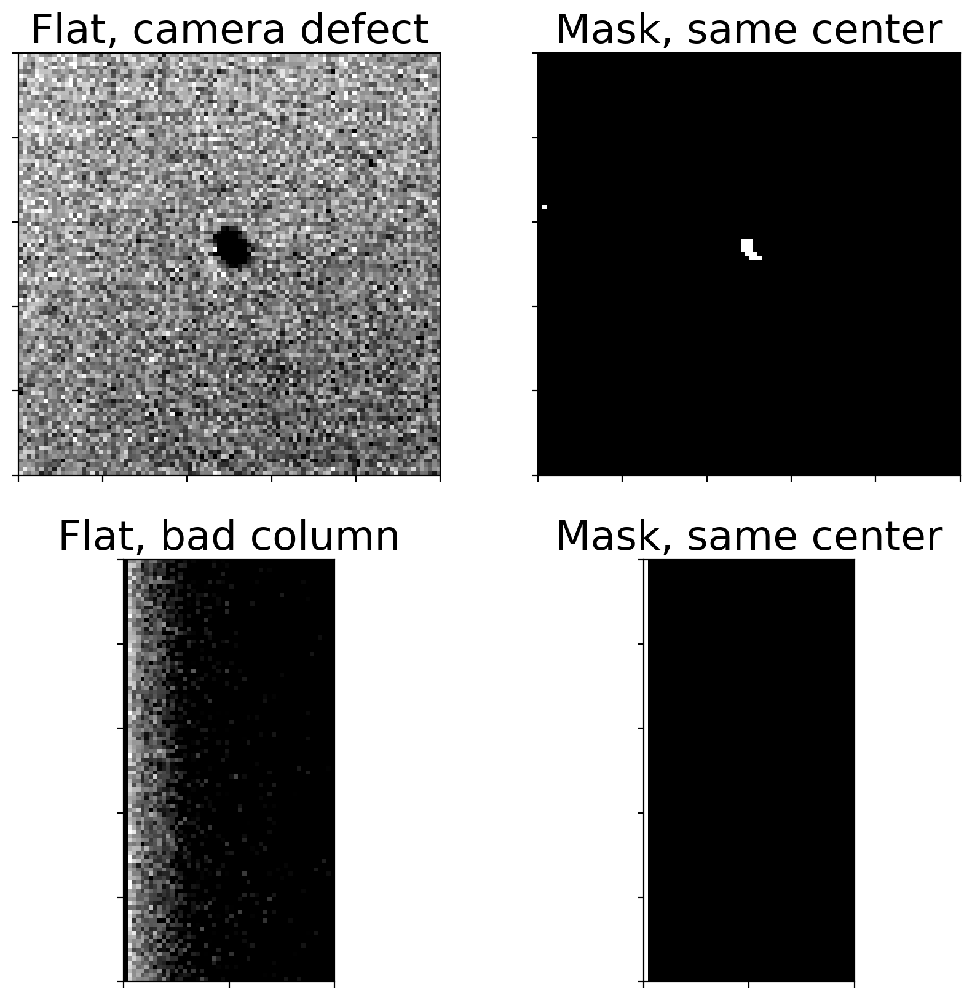

In [11]:
fig, axes = plt.subplots(2, 2, figsize=(10, 10))

width = 100
center = (3823, 2446)
plot_row = 0

image_snippet(ccd1, center, width=width, fig=fig, axis=axes[plot_row, 0])
axes[plot_row, 0].set_title('Flat, camera defect')

image_snippet(maskr, center, width=width, fig=fig, axis=axes[plot_row, 1], is_mask=True)
axes[plot_row, 1].set_title('Mask, same center')

center = (0, 2048)
plot_row = 1

image_snippet(ccd1, center, width=width, fig=fig, axis=axes[plot_row, 0], percu=99.9, percl=70)
axes[plot_row, 0].set_title('Flat, bad column')

image_snippet(maskr, center, width=width, fig=fig, axis=axes[plot_row, 1], is_mask=True)
axes[plot_row, 1].set_title('Mask, same center')

### Saving the mask

[*Click here to comment on this section on GitHub (opens in new tab).*](https://github.com/mwcraig/ccd-reduction-and-photometry-guide/pull/202/files#diff-3d31a738ada4920a4a4656b218ad63efR266){:target="_blank"}

The mask can be saved in a FITS file as an image. We will see in [the summary
notebook on masking]() how to combine the mask generated here with a mask
generated from the dark current and with a cosmic ray mask for each science
image.

In [12]:
mask_as_ccd = CCDData(data=maskr.astype('uint8'), unit=u.dimensionless_unscaled)
mask_as_ccd.header['imagetyp'] = 'flat mask'
mask_as_ccd.write(ex2_path / 'mask_from_ccdmask.fits')

## Making the mask with a single flat

The flats we used in Example 1, taken with the Large Format Camera at Palomar,
are dome flats taken with nearly constant illumination. In that case the best we
can do is run `ccdmask` on a single flat image. As we will see, this still
allows the identification of several clearly bad areas of the chip.

First, a look at the calibratted, but not combined, flat images.

In [13]:
ex1_path = Path('example1-reduced')

ifc1 = ccdp.ImageFileCollection(ex1_path)

flats = (ifc1.summary['imagetyp'] == 'FLATFIELD') & (ifc1.summary['combined'] != True)
ifc1.summary[flats]

file,simple,bitpix,naxis,naxis1,naxis2,date,origin,latitude,longitud,telescop,fratio,instrume,detector,frame,ccdpicno,object,imagetyp,exptime,darktime,date-obs,ut,jd,ra,dec,equinox,epoch,ha,st,airmass,filter,gain,secpix1,secpix2,ccdbin1,ccdbin2,rotangle,datasec,ccdsec,biassec,loginfo,chipid,subtract_overscan,suboscan,trim_image,trimim,bunit,subtract_dark,subdark,flat_correct,flatcor,combined
str27,bool,int64,int64,int64,int64,str10,str34,float64,float64,str17,float64,str3,str14,int64,int64,str7,str9,float64,float64,str10,str12,float64,str12,str12,float64,float64,str12,str12,float64,str2,float64,float64,float64,int64,int64,float64,str15,str15,str18,str18,int64,str8,str46,str6,str13,str3,object,object,object,object,object
flat-ccd.014.0.fits,True,-64,2,2048,4128,2016-01-16,California Institute of Technology,33.4,-116.9,Hale 5m Telescope,7.5,LFC,SITe SI002 x 6,14,14,flat_g,FLATFIELD,70.001,70.673,2016-01-16,04:17:28.00,2457403.678796,04:08:58.50,33:25:12.69,2000.0,2000.0,00:00:04.00,04:10:04.46,1.0,g',1.1,0.182,0.182,1,1,0.0,"[1:2048,1:4128]","[1:2048,1:4128]","[2049:2080,1:4127]",Status=0x00000000,0,suboscan,"ccd=<CCDData>, overscan=<CCDData>, median=True",trimim,ccd=<CCDData>,adu,subdark,"ccd=<CCDData>, master=<CCDData>, exposure_time=exptime, exposure_unit=s",--,--,--
flat-ccd.015.0.fits,True,-64,2,2048,4128,2016-01-16,California Institute of Technology,33.4,-116.9,Hale 5m Telescope,7.5,LFC,SITe SI002 x 6,15,15,flat_g,FLATFIELD,70.011,70.683,2016-01-16,04:20:35.00,2457403.680961,04:12:05.19,33:25:16.79,2000.0,2000.0,00:00:04.00,04:13:11.98,1.0,g',1.1,0.182,0.182,1,1,0.0,"[1:2048,1:4128]","[1:2048,1:4128]","[2049:2080,1:4127]",Status=0x00000000,0,suboscan,"ccd=<CCDData>, overscan=<CCDData>, median=True",trimim,ccd=<CCDData>,adu,subdark,"ccd=<CCDData>, master=<CCDData>, exposure_time=exptime, exposure_unit=s",--,--,--
flat-ccd.016.0.fits,True,-64,2,2048,4128,2016-01-16,California Institute of Technology,33.4,-116.9,Hale 5m Telescope,7.5,LFC,SITe SI002 x 6,16,16,flat_g,FLATFIELD,70.001,70.684,2016-01-16,04:23:41.00,2457403.683113,04:15:12.00,33:25:20.79,2000.0,2000.0,00:00:04.00,04:16:18.49,1.0,g',1.1,0.182,0.182,1,1,0.0,"[1:2048,1:4128]","[1:2048,1:4128]","[2049:2080,1:4127]",Status=0x00000000,0,suboscan,"ccd=<CCDData>, overscan=<CCDData>, median=True",trimim,ccd=<CCDData>,adu,subdark,"ccd=<CCDData>, master=<CCDData>, exposure_time=exptime, exposure_unit=s",--,--,--
flat-ccd.017.0.fits,True,-64,2,2048,4128,2016-01-16,California Institute of Technology,33.4,-116.9,Hale 5m Telescope,7.5,LFC,SITe SI002 x 6,17,17,flat_i,FLATFIELD,7.0,7.683,2016-01-16,04:27:23.00,2457403.685683,04:18:54.58,33:25:25.70,2000.0,2000.0,00:00:04.00,04:20:01.09,1.0,i',1.1,0.182,0.182,1,1,0.0,"[1:2048,1:4128]","[1:2048,1:4128]","[2049:2080,1:4127]",Status=0x00000000,0,suboscan,"ccd=<CCDData>, overscan=<CCDData>, median=True",trimim,ccd=<CCDData>,adu,subdark,"ccd=<CCDData>, master=<CCDData>, exposure_time=exptime, exposure_unit=s",--,--,--
flat-ccd.018.0.fits,True,-64,2,2048,4128,2016-01-16,California Institute of Technology,33.4,-116.9,Hale 5m Telescope,7.5,LFC,SITe SI002 x 6,18,18,flat_i,FLATFIELD,7.0,7.672,2016-01-16,04:29:26.00,2457403.687106,04:20:58.15,33:25:28.39,2000.0,2000.0,00:00:04.00,04:22:04.43,1.0,i',1.1,0.182,0.182,1,1,0.0,"[1:2048,1:4128]","[1:2048,1:4128]","[2049:2080,1:4127]",Status=0x00000000,0,suboscan,"ccd=<CCDData>, overscan=<CCDData>, median=True",trimim,ccd=<CCDData>,adu,subdark,"ccd=<CCDData>, master=<CCDData>, exposure_time=exptime, exposure_unit=s",--,--,--
flat-ccd.019.0.fits,True,-64,2,2048,4128,2016-01-16,California Institute of Technology,33.4,-116.9,Hale 5m Telescope,7.5,LFC,SITe SI002 x 6,19,19,flat_i,FLATFIELD,7.0,7.673,2016-01-16,04:31:30.00,2457403.688542,04:23:01.65,33:25:31.20,2000.0,2000.0,00:00:04.00,04:24:08.77,1.0,i',1.1,0.182,0.182,1,1,0.0,"[1:2048,1:4128]","[1:2048,1:4128]","[2049:2080,1:4127]",Status=0x00000000,0,suboscan,"ccd=<CCDData>, overscan=<CCDData>, median=True",trimim,ccd=<CCDData>,adu,subdark,"ccd=<CCDDa

We can double check that a ratio of flats will not be useful by calculating the
mean counts in each flat image:

In [14]:
ccs = []

for c in ifc1.ccds(imagetyp='flatfield', filter="g'"):
    if 'combined' in c.header:
        continue
    print(c.data.mean())
    ccs.append(c)

19906.38951623411
19902.514437929316
19890.652615963663


The variation in counts is so small that the ratio of two flats will not be
useful.

Instead, we run `ccdmask` on the first flat. There is nothing special about that
one. The kind of defects that `ccdmask` tries to identify are in the CCD sensor
itself and should be the same for all filters.

In [15]:
%%time
ccs1_mask = ccdp.ccdmask(ccs[0])

CPU times: user 43.8 s, sys: 199 ms, total: 44 s
Wall time: 44 s


Displaying the flat we used and the mask side-by-side demonstrates that the
defects which are clear in the flat are picked up in the mask.

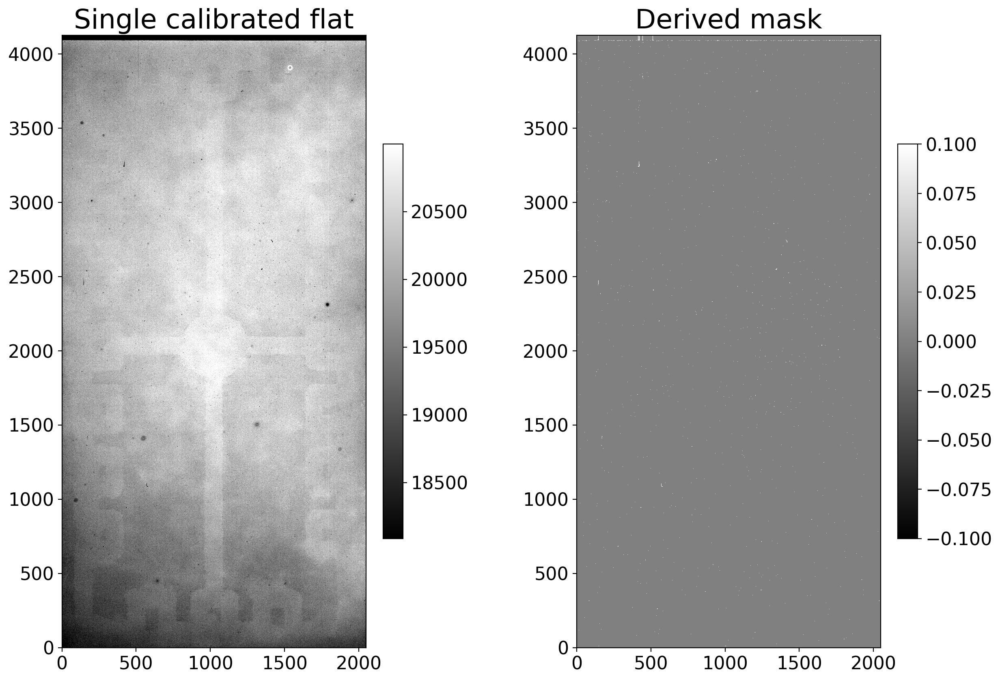

In [16]:
fig, axes = plt.subplots(1, 2, figsize=(15, 10))

show_image(ccs[0], cmap='gray', fig=fig, ax=axes[0])
axes[0].set_title('Single calibrated flat')

show_image(ccs1_mask, cmap='gray', fig=fig, ax=axes[1], is_mask=False)
axes[1].set_title('Derived mask');

A couple of cutouts are shown below illustrating some of the individual defects
identified.

Text(0.5, 1.0, 'Mask, same center')

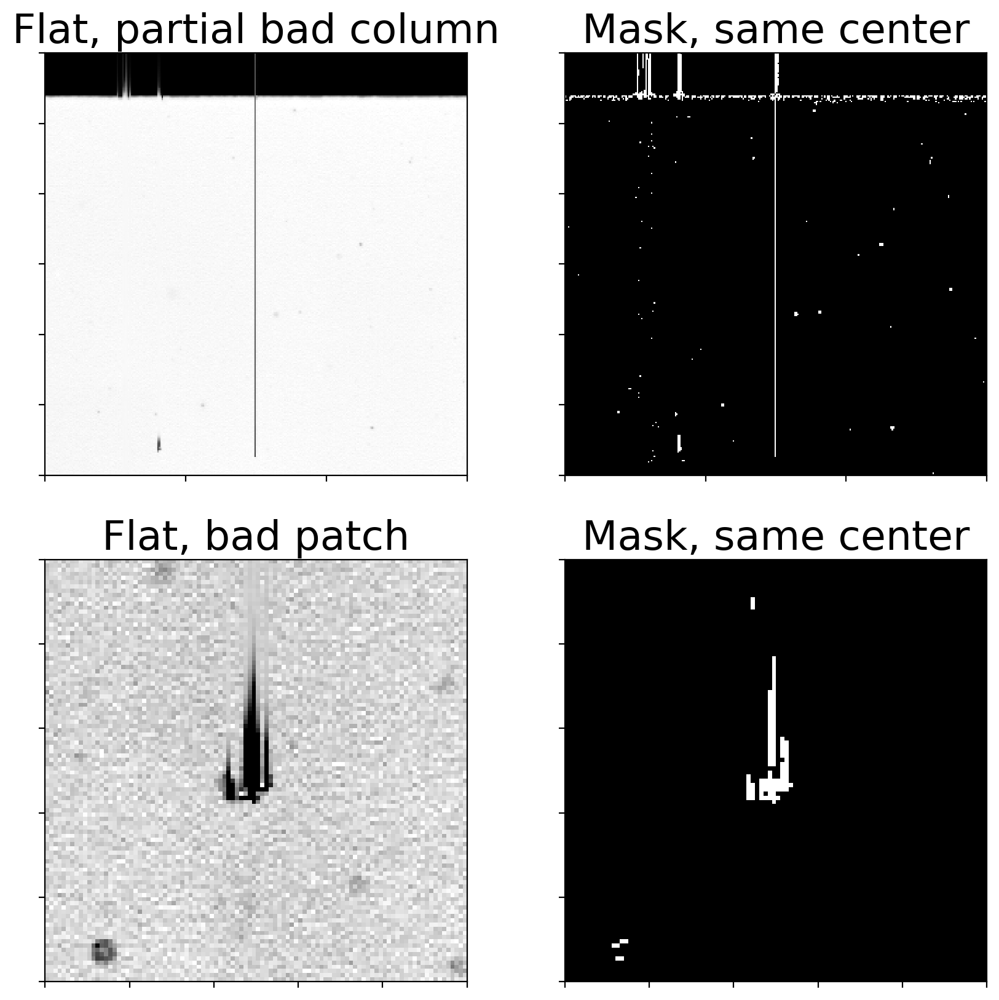

In [17]:
fig, axes = plt.subplots(2, 2, figsize=(10, 10))

width = 300
center = (512, 3976)
plot_row = 0

image_snippet(ccs[0], center, width=width, fig=fig, axis=axes[plot_row, 0])
axes[plot_row, 0].set_title('Flat, partial bad column')

image_snippet(ccs1_mask, center, width=width, fig=fig, axis=axes[plot_row, 1], is_mask=True)
axes[plot_row, 1].set_title('Mask, same center')

center = (420, 3250)
width = 100
plot_row = 1

image_snippet(ccs[0], center, width=width, fig=fig, axis=axes[plot_row, 0])
axes[plot_row, 0].set_title('Flat, bad patch')

image_snippet(ccs1_mask, center, width=width, fig=fig, axis=axes[plot_row, 1], is_mask=True)
axes[plot_row, 1].set_title('Mask, same center')